<Body>   
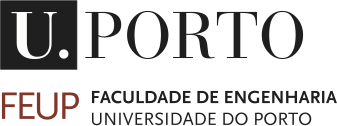   
<h1> <b>Perception and Mapping </b> </h1>
<p><b>Andry Maykol Pinto </b> (amgp@fe.up.pt)</p>
<p>Department of Electrical and Computer Engineering</p>
</Body>  
FEUP

---

# **Group:**
Duarte Ribeiro Afonso Branco (up201905327)
\
Miguel Filipe Santos Silva   (up201904672)

________

# Project about "Visual Inspection of Offshore Structures"

The objective of this assignment is to develop a registration pipeline to process images and point clouds captured by a UAV, and subsequently, generate a textured and denser representation of an offshore structure. Unmanned Aerial Vehicles have become valuable tools for acquiring high-resolution aerial imagery and point clouds, making them ideal for surveying offshore structures such as oil platforms, wind turbines, or coastal infrastructure.

You will face several challenges in this assignment:

1. Data Integration: you will work with a combination of images and point clouds. Integrating these diverse data sources into a unified pipeline can be complex.

2. Point Cloud Texturization: one of the primary objectives is to apply texturing to the point cloud, giving it a realistic appearance. This involves mapping images onto the 3D structure, requiring careful alignment and blending of 2D images onto 3D surfaces (blending techniques are out of scope for Perception and Mapping course).

3. Point Cloud Registration: to create a denser representation, you need to register multiple individual point clouds into a cohesive and complete 3D model. This involves aligning and merging point clouds from different viewpoints.


## Description of the dataset

This assignment use data collected by an Unmanned Aerial Vehicle (UAV) during the inspection routines of a offshore structure in the [ATLANTIS Test Centre](https://www.linkedin.com/company/68810369/). The data retrieved by the UAV includes:

* **Visual information**: obtained by a 640x480 resolution camera. The lens distortion ($D_v$) and intrinsic matrix ($K_v$) are:

* **Thermographic information**: obtained by a 640x512 resolution camera. The lens distortion ($D_t$) and intrinsic matrix ($K_t$) are the following:

* **LiDAR**: is the ouster [OS1-64](https://ouster.com/products/hardware/os1-lidar-sensor) which has 64 channels with a maximum range of 200 metres, a vertical FOV of 45° (± 22.5°) and a precision of ± 0.5 to 3 cm.


The camera frame is the pivotal coordinate system for this dataset which means, the LiDAR and the Thermographic camera have individual frames in relation to the visual frame. The intrinsic and extrinsic calibration data for each sensor is:

> `Dv: [-0.21292081375160646, 0.1767752984756973, 0.00016650108739115778, -7.265397248140523e-05, -0.05302482500821179]`

> `Kv: [791.177953960177, 0.0, 339.436073232339, 0.0, 791.2141134510654, 257.30517663940424, 0.0, 0.0, 1.0]`

> `Dt: [-0.504042, 0.26894, 0.003454, -0.000748, 0.0]`

>`Kt: [767.942728, 0.0, 317.244746, 0.0, 767.068789, 231.644928, 0.0, 0.0, 1.0]`


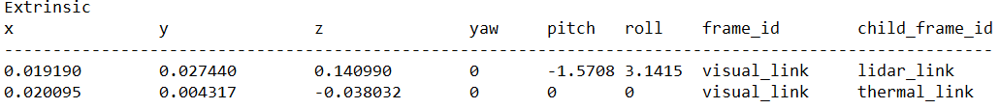

### Sincronization of data

The visual, thermal and point clouds data is timestamped to guarantee the synchronization of sensors. In the real world, there is no exact sincronization (without resorting to hardware sincronization techniques) however, it is possible to select the visual, LiDAR and thermal data with closer timming. This timestamp is encoded directly in the filename of each JPEG or PCD file from the dataset.

* Visual images are named as “image_1693472857**485**557608”
* Point cloud (pcd files) are named as “pointcloud_1693472857**508**994”
* Thermal images are named as “image_1693472857**498**990366



> **This project is focused only on Visual and LiDAR data.**

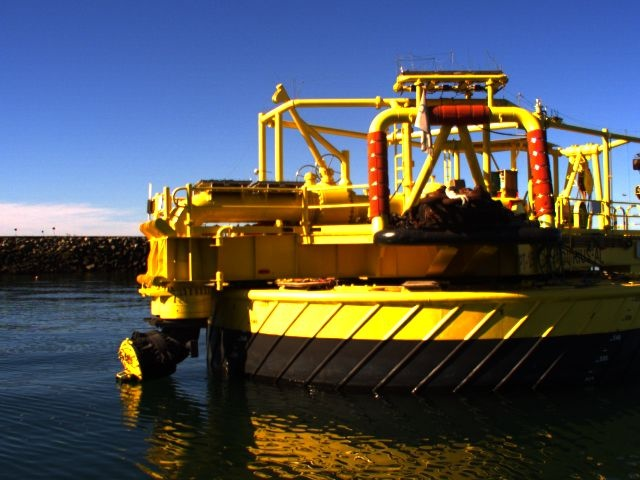

Figure 1 - Visual Images collected by UAV.

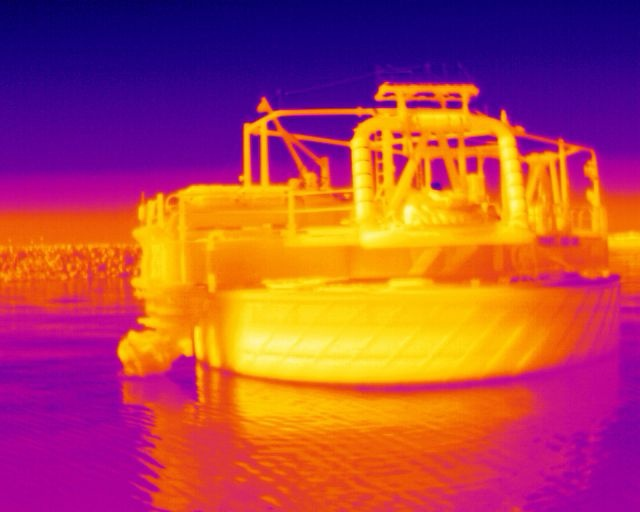

Figure 2 - Thermographic Images collected by UAV.

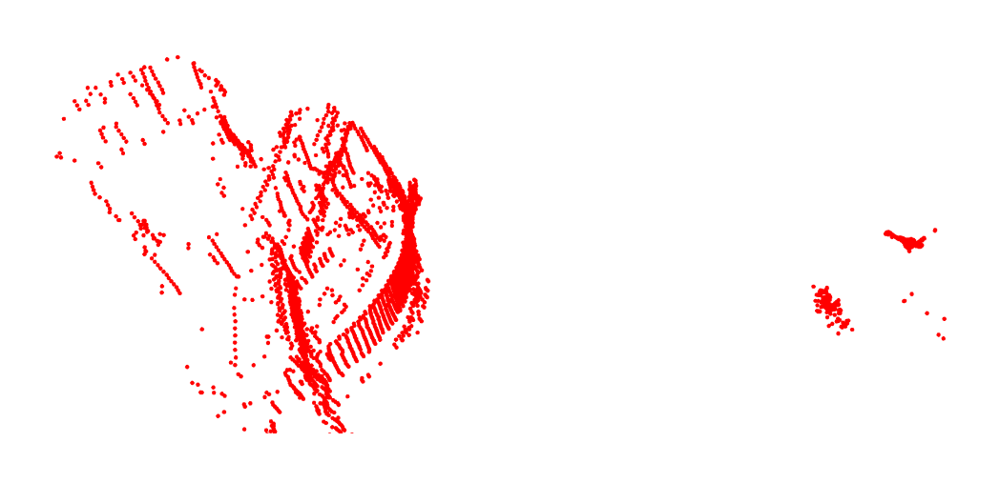

Figure 3 - Point cloud collected by UAV.

## Prepare Libraries and Download dataset

In [1]:
# Install Open3D library
%%capture
!pip install open3d

In [2]:
# Import libraries
import numpy as np
import open3d as o3d
import copy

# Visualization
import plotly.graph_objects as go  # plotly to visualize since COLAB does not allow to use O3D functions
import matplotlib.pyplot as plt    # or, Matplotlib
from mpl_toolkits import mplot3d

In [3]:
# Visualize point cloud as a scatter plot using matplotlib (as an image!)
def plot_pointcloud_matplotlib_singleview (pt, title_ = ' ', view_ =(-90, 90, 0)):
  colors = None
  if pt.has_colors():
      colors = np.asarray(pt.colors)
  elif pt.has_normals():
      colors = (0.5, 0.5, 0.5) + np.asarray(pt.normals) * 0.5
  else:
      pt.paint_uniform_color((1.0, 0.0, 0.0))
      colors = np.asarray(pt.colors)

  points = np.asarray(pt.points)
  # Single View
  ax = plt.axes(projection='3d')
  ax.view_init(view_[0], view_[1], view_[2])
  ax.axis("on")
  ax.scatter(points[:,0], points[:,1], points[:,2], c=colors)
  ax.set_xlabel('X axis')
  ax.set_ylabel('Y axis')
  ax.set_zlabel('Z axis')

  plt.title(title_)
  plt.show()

#Plotly
def draw_geometries(geometries):
    graph_objects = []

    for geometry in geometries:
        geometry_type = geometry.get_geometry_type()

        if geometry_type == o3d.geometry.Geometry.Type.PointCloud:
            points = np.asarray(geometry.points)
            colors = None
            if geometry.has_colors():
                colors = np.asarray(geometry.colors)
            elif geometry.has_normals():
                colors = (0.5, 0.5, 0.5) + np.asarray(geometry.normals) * 0.5
                geometry.colors = o3d.utility.Vector3dVector(colors)
            else:
                geometry.paint_uniform_color((1.0, 0.0, 0.0))
                colors = np.asarray(geometry.colors)

            scatter_3d = go.Scatter3d(x=points[:,0], y=points[:,1], z=points[:,2], mode='markers', marker=dict(size=2, color=colors))
            graph_objects.append(scatter_3d)

        if geometry_type == o3d.geometry.Geometry.Type.TriangleMesh:
            triangles = np.asarray(geometry.triangles)
            vertices = np.asarray(geometry.vertices)
            colors = None
            if geometry.has_triangle_normals():
                colors = (0.5, 0.5, 0.5) + np.asarray(geometry.triangle_normals) * 0.5
                colors = tuple(map(tuple, colors))
            else:
                colors = (1.0, 0.0, 0.0)

            mesh_3d = go.Mesh3d(x=vertices[:,0], y=vertices[:,1], z=vertices[:,2], i=triangles[:,0], j=triangles[:,1], k=triangles[:,2], facecolor=colors, opacity=0.50)
            graph_objects.append(mesh_3d)

        if geometry_type == o3d.geometry.Geometry.Type.VoxelGrid:
            bounds     = geometry.get_max_bound()-geometry.get_min_bound()

            voxels     = geometry.get_voxels()   # Returns List of Voxel
            vox_mesh   = o3d.geometry.TriangleMesh()

            for v in voxels:
                cube = o3d.geometry.TriangleMesh.create_box(width=1, height=1, depth=1)
                cube.paint_uniform_color(v.color)
                cube.translate(v.grid_index, relative=False)
                vox_mesh += cube

            vox_mesh.translate([0.5,0.5,0.5], relative=True)

            vox_mesh.merge_close_vertices(0.0000001)
            # T=np.array([[1, 0, 0, 0],[0, 0, 1, 0],[0, -1, 0, 0],[0, 0, 0, 1]])
            vox_mesh.translate(geometry.origin, relative=True)

            # Now is like a TriangleMesh
            triangles = np.asarray(vox_mesh.triangles)
            vertices = np.asarray(vox_mesh.vertices)
            colors = None
            if vox_mesh.has_triangle_normals():
                colors = (0.5, 0.5, 0.5) + np.asarray(vox_mesh.triangle_normals) * 0.5
                colors = tuple(map(tuple, colors))
            else:
                vox_mesh.compute_vertex_normals()
                colors = (0.5, 0.5, 0.5) + np.asarray(vox_mesh.triangle_normals) * 0.5
                colors = tuple(map(tuple, colors))                                        # or colors = (0, 0, 0)

            mesh_3d = go.Mesh3d(x=vertices[:,0], y=vertices[:,1], z=vertices[:,2], i=triangles[:,0], j=triangles[:,1], k=triangles[:,2], facecolor=colors, opacity=0.50)
            graph_objects.append(mesh_3d)

    fig = go.Figure(
        data=graph_objects,
        layout=dict(
            scene=dict(
                xaxis=dict(visible=True),
                yaxis=dict(visible=True),
                zaxis=dict(visible=True)
            )
        )
    )
    fig.show()

In [4]:
o3d.visualization.draw_geometries = draw_geometries # replacing the function of Open3D

In [5]:
# Download
%%capture
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1gYZkDqykhvMwl_xTOr0Ln_P39BfuMf4G' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1gYZkDqykhvMwl_xTOr0Ln_P39BfuMf4G" -O DURIUS_d1.zip && rm -rf /tmp/cookies.txt

In [6]:
# Extract point clouds from ZIP file.
import zipfile
import os

with zipfile.ZipFile("DURIUS_d1.zip", mode="r") as archive:
  for file in archive.namelist():
    archive.extract(file, "dataset_uav/")

# Part 1 - Point Cloud Texturization
Point clouds provide a powerful representation of 3D environments, capturing the spatial structure of objects and scenes with precision. However, raw point clouds lack visual realism as they consist of untextured geometric points. The challenge in this problem is to develop a point cloud texturization process that enhances the visual quality of point cloud data by mapping 2D textures onto 3D surfaces.

>**Problem Overview:**

>Design a function that receives the point cloud and the image, and uses the extrinsic and intrinsic calibration data to obtain the texture information that will be used to colorize the point cloud acquired by the LiDAR.

> **Expected output:** a point cloud with RGB colors in each point. This RGB color must be obtained using the visual data.



## Loading Images and Point Clouds

Start by selecting a point cloud and a image with similar timestamps.

In [7]:
DIR_PCL = "dataset_uav/data_1/PCD/"
DIR_RGB = "dataset_uav/data_1/RGB/"
DIR_THE = "dataset_uav/data_1/Thermal/"

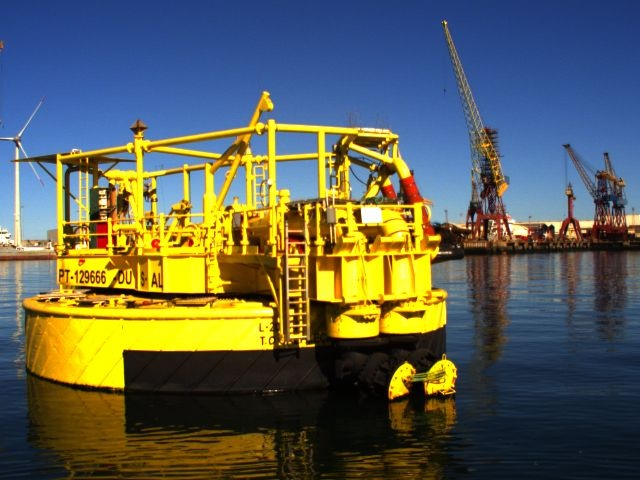

In [8]:
"""
 this example: data is loaded individually. For loading many files --> glob library
"""

import cv2
from google.colab.patches import cv2_imshow
image = cv2.imread(DIR_RGB+"image_1693472866120269331.jpg")
cv2_imshow(image)

# Load a PCD file as a point cloud
pt_example = o3d.io.read_point_cloud(DIR_PCL+"pointcloud_1693472866008728.pcd", format='pcd')
if pt_example.is_empty():
  exit()


In [9]:
o3d.visualization.draw_geometries([pt_example])

### 1.1 Pre-processing the point cloud
Apply some pre-processing techniques to improve the quality of the 3D Data.


In [10]:
def pass_trough_filter(point_cloud, x_range = [15, 40], y_range = [-10, 10], z_range = [-10, 10]):

    copy_point_cloud = copy.deepcopy(point_cloud)

    roi = o3d.geometry.AxisAlignedBoundingBox(min_bound=[x_range[0], y_range[0], z_range[0]],
                                            max_bound=[x_range[1], y_range[1], z_range[1]])

    point_cloud_cropped = copy_point_cloud.crop(roi)

    return point_cloud_cropped

In [11]:
cropped_point_cloud = pass_trough_filter(pt_example, x_range = [15, 40], y_range = [-10, 10], z_range = [-10, 10])

filtered_pt_example = cropped_point_cloud
o3d.visualization.draw_geometries([filtered_pt_example])

### 1.2 Define the Intrinsic and Extrinsic matrices, and transform the data for different coordinates

Use the Open3D objects/methods to modify the coordinate system of the point cloud.

In [12]:
distortion_coefs =  np.array([-0.21292081375160646, 0.1767752984756973, 0.00016650108739115778, -7.265397248140523e-05, -0.05302482500821179])
print("distortion_coefs:\n", distortion_coefs)

intrinsic_matrix = np.array([
    [791.177953960177, 0.0, 339.436073232339],
    [0.0, 791.2141134510654, 257.30517663940424],
    [0.0, 0.0, 1.0]
])

print("intrinsic_matrix:\n", intrinsic_matrix)

tx = 0.019190
ty = 0.027440
tz = 0.140990

roll = 3.1415
pitch = -1.5708
yaw = 0

cr = np.cos(roll)
sr = np.sin(roll)
cp = np.cos(pitch)
sp = np.sin(pitch)
cy = np.cos(yaw)
sy = np.sin(yaw)

extrinsic_translation = np.array([tx, ty, tz])
extrinsic_translation_rotation_matrix = np.array([[cp * cy, -cr * sy + sr * sp * cy, sr * sy + cr * sp * cy],
                                                  [cp * sy, cr * cy + sr * sp * sy, -sr * cy + cr * sp * sy],
                                                  [-sp, sr * cp, cr * cp]])

extrinsic_matrix = np.column_stack((extrinsic_translation_rotation_matrix, extrinsic_translation))
print("extrinsic_matrix:\n", extrinsic_matrix)

distortion_coefs:
 [-2.12920814e-01  1.76775298e-01  1.66501087e-04 -7.26539725e-05
 -5.30248250e-02]
intrinsic_matrix:
 [[791.17795396   0.         339.43607323]
 [  0.         791.21411345 257.30517664]
 [  0.           0.           1.        ]]
extrinsic_matrix:
 [[-3.67320510e-06 -9.26535897e-05  9.99999996e-01  1.91900000e-02]
 [-0.00000000e+00 -9.99999996e-01 -9.26535897e-05  2.74400000e-02]
 [ 1.00000000e+00 -3.40335638e-10  3.67320509e-06  1.40990000e-01]]


In [13]:
import cv2

def calculate_optimal_undistortion(image, height, width, intrinsic_matrix, distortion_coeffs):

    new_intrinsic_matrix, valid_pix_roi = cv2.getOptimalNewCameraMatrix(intrinsic_matrix, distortion_coeffs, imageSize = (width, height), alpha = 1, newImgSize = (width, height))

    undistorted_image = None
    undistorted_image = cv2.undistort(image, intrinsic_matrix, distortion_coeffs, dst = None, newCameraMatrix = new_intrinsic_matrix)

    x, y, w, h = valid_pix_roi
    undistorted_image = undistorted_image[y : y + h, x : x + w]

    return undistorted_image

In [14]:
def convert_world_point_to_camera_point(Pw, P): # P is extrinsic matrix

    Pw = np.append(Pw, 1) # Pw = [Xw, Yw, Zw, 1]
    Pw = np.array(Pw).reshape(-1, 1)

    #print("P shape: ", P.shape, " * Pw shape: ", Pw.shape)

    Pc = np.dot(P, Pw)

    #print("Pc shape: ", Pc.shape)

    return Pc#.flatten()  # Flatten to return as horizontal array

def point_clould_world_ref_to_camera_ref(point_cloud, extrinsic_matrix):

    points_camera_ref = []

    for i in range(len(point_cloud.points)):

        world_point = np.array(point_cloud.points[i])

        camera_point = convert_world_point_to_camera_point(world_point, extrinsic_matrix)

        points_camera_ref.append(camera_point)

    return np.hstack(points_camera_ref) # np.hstack to make it a matrix 3xn

import copy



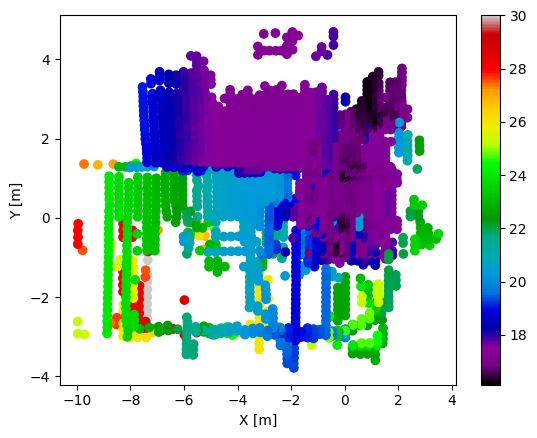

In [15]:
points_camera_ref = point_clould_world_ref_to_camera_ref(filtered_pt_example, extrinsic_matrix)
#print("points_camera_ref shape: ", points_camera_ref.shape)
points          = np.asarray(points_camera_ref.T)
#print("points shape: ", points.shape)


pt_cloud = o3d.geometry.PointCloud()
pt_cloud.points = o3d.utility.Vector3dVector(points)
o3d.visualization.draw_geometries([pt_cloud])

# plot
fig, ax = plt.subplots()
sc = ax.scatter(points[:,0], points[:,1], c=points[:,2], cmap="nipy_spectral")
plt.xlabel("X [m]")
plt.ylabel("Y [m]")
plt.colorbar(sc)
plt.show()


### 1.3 Convert 3D Points to Image Plane, and show each 2D point in the RGB image

In [16]:
def convert_Pc_point_to_image_plane(Pc, K): # Pc is camera point, K is instrisic matrix

    result = np.dot(K, Pc)

    z_alpha = result[2]

    u = result[0]
    v = result[1]

    return u, v, z_alpha

def convert_point_cloud_camera_ref_to_pixel_depth(point_cloud_camera_ref, intrinsic_matrix):
    pixel_depth = np.zeros((3, len(point_cloud_camera_ref.points)))  # Set up for x, y, z = 0

    for i, point in enumerate(point_cloud_camera_ref.points):
        point = np.array(point)

        u, v, z_alpha = convert_Pc_point_to_image_plane(point.T, intrinsic_matrix)

        pixel_depth[0, i] = u / z_alpha
        pixel_depth[1, i] = v / z_alpha
        pixel_depth[2, i] = z_alpha

    return pixel_depth


def convert_pixel_depth_to_range_map(pixel_depth, height, width):
    range_map = np.zeros((height, width), dtype=np.uint8)
    num_pixels = pixel_depth.shape[1]

    max_depth = np.max(pixel_depth[2])

    for i in range(num_pixels):
        pixel_x = int(pixel_depth[0, i])
        pixel_y = int(pixel_depth[1, i])
        depth = pixel_depth[2, i]

        # Normalize depth proporcional to max depth
        normalized_depth = int((depth / max_depth) * 255)

        if 0 <= pixel_x < width and 0 <= pixel_y < height:
            range_map[pixel_y, pixel_x] = normalized_depth

    return range_map



In [17]:
depth_map_pt = convert_point_cloud_camera_ref_to_pixel_depth(pt_cloud, intrinsic_matrix)

In [18]:
#cv2_imshow(image)
#print("image shape: ", image.shape)

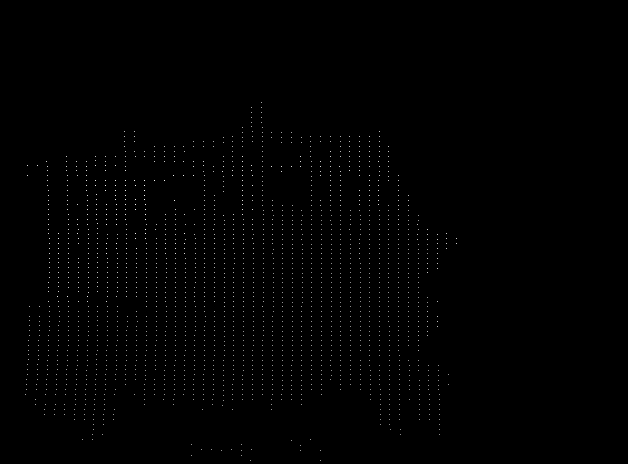

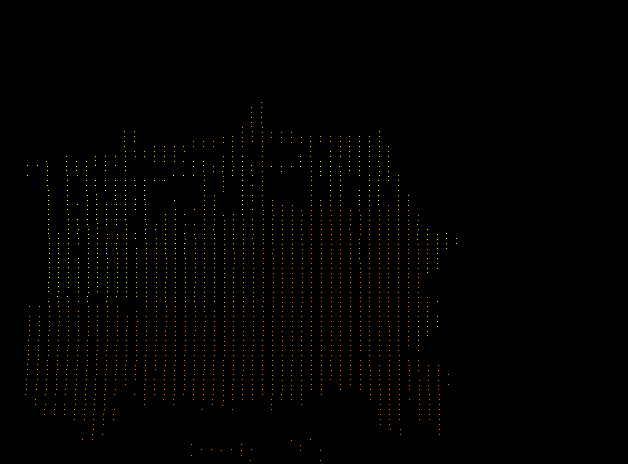

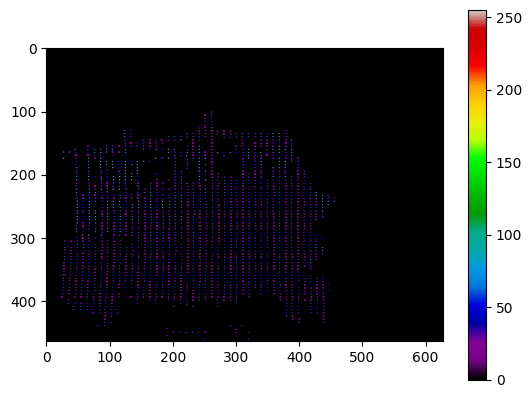

In [19]:
# Show the 3D -> 2D image projection
pp_3D_2D_projection        = np.array(depth_map_pt.T) # .T cuz Vector3dVector need shape n,3
pt_image_projection        = o3d.geometry.PointCloud()
pt_image_projection.points = o3d.utility.Vector3dVector(pp_3D_2D_projection)
o3d.visualization.draw_geometries([pt_image_projection])


undistorted_image = calculate_optimal_undistortion(image, image.shape[0], image.shape[1], intrinsic_matrix, distortion_coefs)

range_map = convert_pixel_depth_to_range_map(depth_map_pt, undistorted_image.shape[0], undistorted_image.shape[1])
cv2_imshow(range_map)
# Show the 3D -> 2D projection using OpenCV Color Map
range_map_color = cv2.applyColorMap(cv2.cvtColor(range_map, cv2.COLOR_GRAY2BGR), cv2.COLORMAP_HOT)  # COLORMAP_HOT   COLORMAP_RAINBOW (is inverted HOT)
cv2_imshow(range_map_color)

# Show the 3D -> 2D projection using Matplotlib
plt.imshow(range_map, cmap="nipy_spectral")
plt.colorbar()

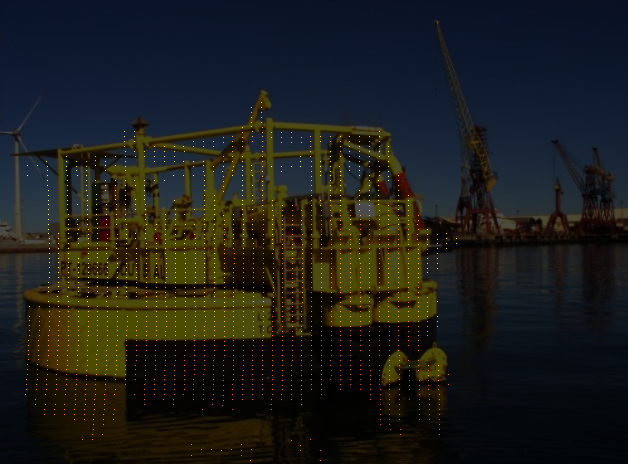

In [20]:
#Overlaying
undistorted_image_show = undistorted_image.copy()

image_projection_color = undistorted_image_show*0.3 + range_map_color*0.9
cv2_imshow(image_projection_color)

### 1.4 Colorize the Point cloud of the DURIUS taking into consideration the RGB data from the Image

In [21]:
def paint_point_cloud(point_cloud_pixel_ref, image):

    copy_point_cloud = copy.deepcopy(point_cloud_pixel_ref)
    height, width = image.shape[:2]


    copy_point_cloud.paint_uniform_color((1.0, 0.0, 0.0)) # Initialize the .colors array


    for i, point in enumerate(np.asarray(copy_point_cloud.points)):
        image_x = int(point[0])
        image_y = int(point[1])

        if 0 <= image_y < height and 0 <= image_x < width:

            bgr = image[image_y, image_x, :]
            #print("bgr shape: ", bgr.shape)

            rgb = [bgr[2] / 255, bgr[1] / 255, bgr[0] / 255] # /255 cuz .colors 0...1
            rgb = np.array(rgb).reshape(-1, 1) # reshape to be 3x1
            #print("rgb shape: ", rgb.shape)

            copy_point_cloud.colors[i] = rgb

    return copy_point_cloud


def paint_point_cloud_full_pipeline(image, point_cloud, extrinsic_matrix, intrinsic_matrix, distortion_coefs, plot = False):

    # Crop, remove outliers
    cropped_point_cloud = pass_trough_filter(point_cloud, x_range = [15, 40], y_range = [-10, 10], z_range = [-10, 10])

    # Convert to camera ref
    points_camera_ref = point_clould_world_ref_to_camera_ref(cropped_point_cloud, extrinsic_matrix)
    point_cloud_camera_ref = o3d.geometry.PointCloud()
    point_cloud_camera_ref.points = o3d.utility.Vector3dVector(np.asarray(points_camera_ref.T))

    # Convert to pixel coords, keep z value
    points_pixel_depth = convert_point_cloud_camera_ref_to_pixel_depth(point_cloud_camera_ref, intrinsic_matrix)
    point_cloud_pixel_ref = o3d.geometry.PointCloud()
    point_cloud_pixel_ref.points = o3d.utility.Vector3dVector(np.array(points_pixel_depth.T))
    #o3d.visualization.draw_geometries([point_cloud_pixel_ref])

    undistorted_image = calculate_optimal_undistortion(image, image.shape[0], image.shape[1], intrinsic_matrix, distortion_coefs)

    # Colorize
    point_cloud_pixel_ref_painted = paint_point_cloud(point_cloud_pixel_ref, undistorted_image)

    #Remove default red points, by nature they are outliers since they cant be matched with the image
    good_points = []
    good_colors = []
    for i in range(len(point_cloud_pixel_ref_painted.points)):
        rgb = np.asarray(point_cloud_pixel_ref_painted.colors[i])

        if (rgb[0] == 1.0 and rgb[1] == 0.0 and rgb[2] == 0.0):
            #print("removed red")
            continue

        good_points.append(point_cloud_pixel_ref_painted.points[i])
        good_colors.append(point_cloud_pixel_ref_painted.colors[i])

    point_cloud_pixel_ref_painted_filtered = o3d.geometry.PointCloud()
    point_cloud_pixel_ref_painted_filtered.points = o3d.utility.Vector3dVector(good_points)
    point_cloud_pixel_ref_painted_filtered.colors = o3d.utility.Vector3dVector(good_colors)

    if(True == plot):
        cv2_imshow(image)
        o3d.visualization.draw_geometries([point_cloud_pixel_ref_painted_filtered])

    return point_cloud_pixel_ref_painted_filtered


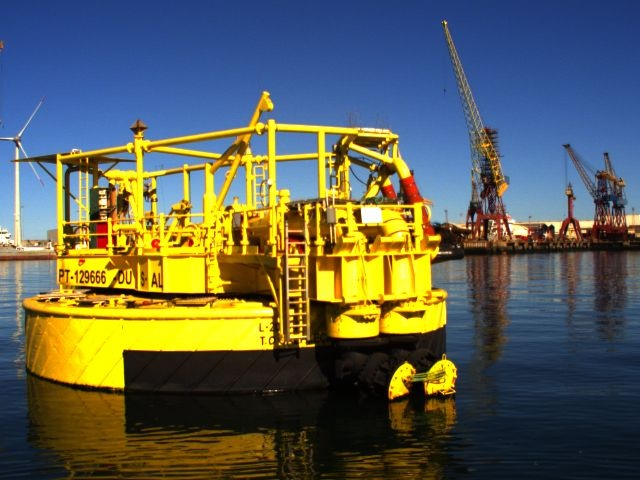

In [22]:
point_cloud_pixel_ref_painted = paint_point_cloud_full_pipeline(image, pt_example, extrinsic_matrix, intrinsic_matrix, distortion_coefs, plot = True)

### 1.5 Save the final point cloud with texture

In [23]:
import os

def get_file_paths_in_directory(directory):

    file_paths = []
    if os.path.exists(directory):
        for file in os.listdir(directory):
            if os.path.isfile(os.path.join(directory, file)):
                file_paths.append(directory+file)
    return file_paths

    point_cloud_file_paths = get_file_paths_in_directory(DIR_PCL)
    image_file_paths = get_file_paths_in_directory(DIR_RGB)

def associate_image_to_cloud_point(image_file_paths, point_cloud_file_paths):
    image_point_cloud_file_paths = []

    # Extract and organize timestamps from image file paths
    image_timestamps = [int(os.path.basename(image).split("_")[1].split(".")[0]) for image in image_file_paths]
    sorted_image_paths = [x for _, x in sorted(zip(image_timestamps, image_file_paths))]

    # Extract and organize timestamps from point cloud file paths
    point_cloud_timestamps = [int(os.path.basename(point_cloud).split("_")[1].split(".")[0]) for point_cloud in point_cloud_file_paths]
    sorted_point_cloud_paths = [x for _, x in sorted(zip(point_cloud_timestamps, point_cloud_file_paths))]

    for i in range(len(sorted_image_paths)):
        image_path = sorted_image_paths[i]
        point_cloud_path = sorted_point_cloud_paths[i]

        image_point_cloud_file_paths.append((image_path, point_cloud_path))

    return image_point_cloud_file_paths


def paint_save_all_point_clouds(image_directory, point_cloud_directory, extrinsic_matrix, intrinsic_matrix, distortion_coefs, save_directory="painted_point_clouds", plot=False):

    # Create directory, if it already exists delete files
    if not os.path.exists(save_directory):
        os.makedirs(save_directory)
    else:
        # Remove files in the directory
        for filename in os.listdir(save_directory):
            file_path = os.path.join(save_directory, filename)
            try:
                if os.path.isfile(file_path):
                    os.remove(file_path)
            except Exception as e:
                print(f"Error while deleting {file_path}: {e}")


    image_point_cloud_file_paths = associate_image_to_cloud_point(get_file_paths_in_directory(image_directory), get_file_paths_in_directory(point_cloud_directory))
    list_point_cloud_pixel_ref_painted = []
    list_appended_images = []

    for i in range(len(image_point_cloud_file_paths)):
        if plot:
            print("Image:", image_point_cloud_file_paths[i][0], "Point Cloud:", image_point_cloud_file_paths[i][1])

        image = cv2.imread(image_point_cloud_file_paths[i][0])
        point_cloud = o3d.io.read_point_cloud(image_point_cloud_file_paths[i][1], format='pcd')

        point_cloud_pixel_ref_painted = paint_point_cloud_full_pipeline(image, point_cloud, extrinsic_matrix, intrinsic_matrix, distortion_coefs, plot=plot)

        list_point_cloud_pixel_ref_painted.append(point_cloud_pixel_ref_painted)
        list_appended_images.append(image)

        # Save painted point cloud
        save_filename = "painted_" + os.path.splitext(os.path.basename(image_point_cloud_file_paths[i][1]))[0]
        save_file_path = os.path.join(save_directory, save_filename + ".pcd")
        o3d.io.write_point_cloud(save_file_path, point_cloud_pixel_ref_painted)
        #print("Saved: ", save_filename)

    return list_point_cloud_pixel_ref_painted, list_appended_images

In [24]:
point_cloud_pixel_ref_painted_list, list_images = paint_save_all_point_clouds(DIR_RGB, DIR_PCL, extrinsic_matrix, intrinsic_matrix, distortion_coefs, save_directory="painted_point_clouds", plot = False)

## **Discussion Part 1**

Firstly, a pass-trough filter was applied to the point cloud in order to define a region of interest containing only the structure, thus removing the outliers of the point cloud created by reflections with water.

The next step was to define the distortion coefficients and the intrinsic and extrinsic matrices with the provided information. The extrinsic matrix was used to convert the point cloud from the world referencial into the camera referencial. Consequently, the intrinsic matrix was used to convert the points from the camera referencial to the image-plance referencial, where the point coordinates represented the pixel coordinates and depth. The distortion coefficients and the intrinsic matrix were used to undistort the provided image. These transformations resulted in a point with the following shape [u', v', z] where u' and v' represent the 2D image plane point and z represents the depth from the camera point origin. Finally, the resulting range map and depth map were plotted.

Colorizing the point cloud was achieved by associating the color in a pixel of the undistorted image with the coordinates of the point cloud in the image-plane referencial. This was done by iterating over all the points in the point cloud and using the int() of the u' and v' to identify the pixel of the image and take the corresponding color. The point cloud color array was initialized with the color red ([1, 0, 0]) and every time a match was found between the point cloud points and image pixels the corresponding color was placed in the color array. However, some (around 4) points in the point cloud didn't match any of the image pixels, so these were removed from the painted point cloud since they couldn't be painted.

Finally, a pipeline was developed to paint all the point clouds and save them in the folder painted_point_clouds.



# Part 2 - Developing a 3D Registration Pipeline

The challenge in this problem is to design and implement a colorized registration pipeline that aligns multiple point clouds with associated color information to create a unified, high-fidelity 3D model.



>**Problem Overview:**

> Develop a colorized point cloud registration system that takes multiple input point clouds, each with associated color data, and aligns them into a single, coherent 3D model. The goal is to preserve both the geometric accuracy and color consistency across the merged point clouds, enhancing the visual realism and information content.

> **Expected output:** an unified point cloud with RGB colors representing the DURIUS infrastructure.

* **50% of penalization:** if *> 75% of all point clouds available* in the dataset are used to create the unified point cloud.

* **25% of penalization:** if *> 25% of all point clouds available* in the dataset are used to create the unified point cloud.

* **0% of penalization:** for implemementations that produce an unified point cloud using *only 12 point clouds retrieved uniformly from all dataset*.





## 2.1 Prepare the dataset that will be used for the registration

a) Select the raw point clouds and images that will be used for the registration process.

b) Load and colorize the point clouds using the function designed in Part1 of this assignment.

c) Save each point cloud (with texture). Show explicitly the number of point clouds that have been processed.

In [25]:
def create_point_cloud_list(list_all_point_clouds, list_all_images, percentage = 11, offset = 0, plot = False):
    '''
    Creates a list for the point clouds that will be used for the unified point cloud. This list is created uniformly without processing or comparison of point cloud quality
    @ list_all_points: List that contains point clouds
    @ percentage: percentage of point clouds that will be used. 11% is equal to 12 point clouds
    @ offset: To change the points cloud starting point and test with different PCs.
    '''

    number_of_pcs = int(percentage / 100.0 * (len(list_all_point_clouds)))
    print("Creating a list with ", number_of_pcs, " Point Clouds.")

    # Max offset for a given percentage
    list_length = len(list_all_point_clouds)

    allowed_offset = int( (list_length - 1) - ((list_length / number_of_pcs) * (number_of_pcs - 1)) - 1)

    if(offset > allowed_offset):
        print("Defined offset too high, setting it to the max allowed : ",allowed_offset,"!")
        offset = allowed_offset

    j = 0
    i = 0
    list_to_process_point_clouds = []
    list_to_process_images = []
    while(j < (list_length)):
        # print("Iteration ", i ," with point cloud number ", j + offset, round(j) + offset)
        #if((round(j) + offset) >= list_length):
        list_to_process_point_clouds.append(list_all_point_clouds[round(j) + offset])
        list_to_process_images.append(list_all_images[round(j) + offset])
        if(plot):
            draw_geometries([list_all_point_clouds[round(j) + offset]])
        i+= 1
        j = j + (list_length / number_of_pcs)



    return list_to_process_point_clouds, list_to_process_images

In [26]:
list_mix_point_clouds, list_mix_images = create_point_cloud_list(point_cloud_pixel_ref_painted_list, list_images, percentage = 11, offset = 0, plot = False)

Creating a list with  12  Point Clouds.


## 2.2 Estimate a transformation matrix for each point cloud

### 2.2.1 Filters

In [27]:
def pca_compute(data, sort=True):
    """
	SVD decomposition
    """
    # data = (Nx3)
    average_data = np.mean(data, axis=0)
    decentration_matrix = data - average_data
    H = np.dot(decentration_matrix.T, decentration_matrix)
    eigenvectors, eigenvalues, eigenvectors_T = np.linalg.svd(H)
    if sort:
        sort        = eigenvalues.argsort()[::-1]
        eigenvalues = eigenvalues[sort]
    return eigenvalues

# Curvature-based keypoint detection
def calculate_surface_curvature(cloud, radius=0.003):
    points     = np.asarray(cloud.points)
    kdtree     = o3d.geometry.KDTreeFlann(cloud)
    num_points = len(cloud.points)
    curvature  = []
    for i in range(num_points):
        k, idx, _ = kdtree.search_radius_vector_3d(cloud.points[i], radius)
        neighbors = points[idx, :]
        w         = pca_compute(neighbors)
        delt      = np.divide(w[2], np.sum(w), out=np.zeros_like(w[2]), where=np.sum(w) != 0)
        curvature.append(delt)
    curvature = np.array(curvature, dtype=np.float64)
    return curvature

In [28]:
#### Curvature based feature extraction ####

######
# The bad points have bad curvature and with 1700 points, we seem to get all the points corresponding to the structure, without reflection
# When increasing the radius, it finds less features/curvature, being the water very minimal.
# Radius 5 seems ideal, less than that is too agressive and gives an error, too much ~10 radius basically has no use at all.
# Voxel size doesn't seem to change much. The point cloud is already small so we don't want to be reducing it even more.
######

def calculate_curvature_keypoints_cloud(pt_function, plot = False, radius = 5):

    #Copy pt
    pt_pre_curvature = copy.deepcopy(pt_function) # https://docs.python.org/3/library/copy.html
    pt_downsampled = copy.deepcopy(pt_function)

    #Calculate the curvature for the point cloud
    surface_curvature = calculate_surface_curvature(pt_downsampled, radius=radius)

    ## Extract the keypoints
    # Love it for 1700 point
    # TODO: do it based on threshold??
    keypoint_idx    = (-surface_curvature).argsort()[:1700]   #Obtaining the 30 max curvatures
    pt_keypoints    = pt_downsampled.select_by_index(keypoint_idx)

    if plot:
        print("Extracted ", len(keypoint_idx), " keypoints")
        draw_geometries([pt_keypoints])

    return pt_keypoints

# pt_curvature_keypoints = calculate_curvature_keypoints_cloud(list_mix_point_clouds[0], plot = True)

In [29]:
#### ISS Feature Extration ####
#####
# ISS computing test results:
# keypoints_iss = o3d.geometry.keypoint.compute_iss_keypoints(pt_cloud, salient_radius = 4.0, gamma_21 = 2.2, gamma_32 =1.3, min_neighbors  = 5 )
# Original, points on water, don't like
# Different gamma21, worse, keypoints in invalid places
# More neighbours, no points on water down, 19 points
# More Radius, close to original. points on water down, 24 points
######

## Apply ISS to images array
def get_keypoints_iss(pt_function, salient_radius = 8.0, min_neighbours = 10, voxel_size = 1, plot = False):
    # The best parameters tested so far
    initial_pt_cloud = copy.deepcopy(pt_function)

    keypoints_iss = o3d.geometry.keypoint.compute_iss_keypoints(initial_pt_cloud, salient_radius = salient_radius, gamma_21 = 2.2, gamma_32 =1.3, min_neighbors  = min_neighbours )    # More neighbours, no points on water down, better than above 19 points.

    if plot:
        copy_kp_iss = copy.deepcopy(keypoints_iss)
        pt_downsampled = copy.deepcopy(pt_function)

        # Paint different from structure
        copy_kp_iss.paint_uniform_color([0, 1.0, 0])  # paint point cloud Green

        npcolors_1               = np.asarray(pt_downsampled.colors)
        npcolors_2               = np.asarray(copy_kp_iss.colors)

        nppoints_1               = np.asarray(pt_downsampled.points)
        nppoints_2               = np.asarray(copy_kp_iss.points)

        npcolors = np.append(npcolors_1, npcolors_2, axis=0)
        nppoints = np.append(nppoints_1, nppoints_2, axis=0)

        pt_downsampled.colors        = o3d.utility.Vector3dVector(npcolors[:, :3])
        pt_downsampled.points        = o3d.utility.Vector3dVector(nppoints[:, :3])

        # Plot
        print("ISS with ", len(copy_kp_iss.points), " points")
        draw_geometries([copy_kp_iss])

    return keypoints_iss

In [30]:
def draw_registration_result(source, target, transformation):
    source_temp = copy.deepcopy(source)
    target_temp = copy.deepcopy(target)
    source_temp.transform(transformation)

    o3d.visualization.draw_geometries([source_temp, target_temp])

### 2.2.2 - Global Registration - RANSAC



In [31]:
## Extract geometric features
def preprocess_point_cloud(pcd, voxel_size):

    pcd_down = copy.deepcopy(pcd)
    pcd_down = pcd_down.voxel_down_sample(voxel_size)

    radius_normal = voxel_size * 2
    pcd_down.estimate_normals(
        o3d.geometry.KDTreeSearchParamHybrid(radius=radius_normal, max_nn=30))

    radius_feature = voxel_size * 5
    pcd_fpfh = o3d.pipelines.registration.compute_fpfh_feature(pcd_down, o3d.geometry.KDTreeSearchParamHybrid(radius=radius_feature, max_nn=100))

    #print("pcd down")
    #o3d.visualization.draw_geometries([pcd_down])

    return pcd_down, pcd_fpfh


def prepare_pc_for_fpfh(source, target, voxel_size = 1.0):

    # draw_registration_result(source, target, np.identity(4))

    source_down, source_fpfh = preprocess_point_cloud(source, voxel_size)
    target_down, target_fpfh = preprocess_point_cloud(target, voxel_size)

    return source_down, target_down, source_fpfh, target_fpfh


In [32]:
# Try with both
# - FPFH. This seems different from the others beacuse this is a feature descriport while the others are feature extractures
def execute_global_registration(source_down, target_down, source_fpfh,
                                target_fpfh,  distance_threshold):

    #print(":: RANSAC registration on downsampled point clouds.")
    result = o3d.pipelines.registration.registration_ransac_based_on_feature_matching(source_down,
                                                                                      target_down,
                                                                                      source_fpfh,
                                                                                      target_fpfh,
                                                                                      True,
                                                                                      distance_threshold,
                                                                                      o3d.pipelines.registration.TransformationEstimationPointToPoint(False),
                                                                                      3,
                                                                                      [o3d.pipelines.registration.CorrespondenceCheckerBasedOnEdgeLength(0.9),
                                                                                      o3d.pipelines.registration.CorrespondenceCheckerBasedOnDistance(distance_threshold)],
                                                                                      o3d.pipelines.registration.RANSACConvergenceCriteria(100000, 100))

    return result



In [33]:
### Apply Global registration

def do_ransac_registration(source_pt, target_pt, voxel_size, plot = False):

    distance_threshold = voxel_size# * 1.5

    source_down, target_down, source_fpfh, target_fpfh = prepare_pc_for_fpfh(source_pt, target_pt)

    ransac_result = execute_global_registration(source_down, target_down,
                                                source_fpfh, target_fpfh,
                                                distance_threshold)

    if plot:
        print("Ransac:")
        evaluation = o3d.pipelines.registration.evaluate_registration(source_down, target_down, distance_threshold * 0.7, ransac_result.transformation)
        print(evaluation)
        draw_registration_result(source_down, target_down, ransac_result.transformation)

    return source_down, target_down, ransac_result

### 2.2.3 Local Registration - ICP

In [34]:
### ICP CODE ####
# TODO: Try different threshold values
# TODO: try ICP to plane
def do_icp_registration(source_pt, target_pt, ransac_transform, voxel_size, max_iterations = 2000, plot = False):

    distance_threshold = voxel_size * 0.4

    icp_result = o3d.pipelines.registration.registration_icp(source_pt,
                                                            target_pt,
                                                            distance_threshold,
                                                            ransac_transform,
                                                            o3d.pipelines.registration.TransformationEstimationPointToPoint(),
                                                            o3d.pipelines.registration.ICPConvergenceCriteria(max_iteration = max_iterations))
    # icp_result = o3d.pipelines.registration.registration_colored_icp(
    #                                                                 source_pt,
    #                                                                 target_pt,
    #                                                                 distance_threshold,
    #                                                                 ransac_transform,
    #                                                                 o3d.pipelines.registration.TransformationEstimationForColoredICP(),
    #                                                                 o3d.pipelines.registration.ICPConvergenceCriteria(max_iteration=max_iterations)
    #                                                                 )

    if plot:
        print("ICP: ")
        #print(icp_result)
        evaluation = o3d.pipelines.registration.evaluate_registration(source_pt, target_pt, distance_threshold, icp_result.transformation)
        print(evaluation)
        draw_registration_result(source_pt, target_pt, icp_result.transformation)


    return icp_result

### 2.2.4 Full Registration Pipeline

In [35]:
def apply_registration_pipeline(source_pt, target_pt, voxel_size = 1, plot = False):


    source_pt_copy = copy.deepcopy(source_pt)
    target_pt_copy = copy.deepcopy(target_pt)

    source_down, target_down, ransac_result = do_ransac_registration(source_pt, target_pt, voxel_size, plot = plot)
    icp_result = do_icp_registration(source_down, target_down, ransac_result.transformation, voxel_size, max_iterations = 2000, plot = plot)

    return icp_result

In [36]:
def full_registration_pipeline(pt_list, voxel_size = 10, plot = False):

    #print("Target point cloud index: 0")
    pt_target = copy.deepcopy(pt_list[0])
    pt_list_registered = []
    pt_list_registered.append(pt_target)

    for i in range(1, len(pt_list)):
        print("----------------Registration from Source of point cloud of index: ", i, "to target point cloud of index 0.")

        pt_source = copy.deepcopy(pt_list[i])
        registration_result = apply_registration_pipeline(pt_source, pt_target, voxel_size = voxel_size, plot = plot)

        #print(registration_result)

        pt_list_registered.append(pt_source.transform(registration_result.transformation))
        print("----------------Registration over. \n\n\n")

    print("Full pipeline Point Clouds")
    draw_geometries(pt_list_registered)

    return pt_list_registered

In [37]:
pt_list_registered = full_registration_pipeline(list_mix_point_clouds, voxel_size = 10, plot = True)

----------------Registration from Source of point cloud of index:  1 to target point cloud of index 0.
Ransac:
RegistrationResult with fitness=9.791123e-01, inlier_rmse=4.067415e+00, and correspondence_set size of 2250
Access transformation to get result.


ICP: 
RegistrationResult with fitness=9.303742e-01, inlier_rmse=5.181504e-01, and correspondence_set size of 2138
Access transformation to get result.


----------------Registration over. 



----------------Registration from Source of point cloud of index:  2 to target point cloud of index 0.
Ransac:
RegistrationResult with fitness=9.743363e-01, inlier_rmse=3.741974e+00, and correspondence_set size of 2202
Access transformation to get result.


ICP: 
RegistrationResult with fitness=8.858407e-01, inlier_rmse=7.382169e-01, and correspondence_set size of 2002
Access transformation to get result.


----------------Registration over. 



----------------Registration from Source of point cloud of index:  3 to target point cloud of index 0.
Ransac:
RegistrationResult with fitness=9.781931e-01, inlier_rmse=4.438517e+00, and correspondence_set size of 2198
Access transformation to get result.


ICP: 
RegistrationResult with fitness=9.154428e-01, inlier_rmse=6.397262e-01, and correspondence_set size of 2057
Access transformation to get result.


----------------Registration over. 



----------------Registration from Source of point cloud of index:  4 to target point cloud of index 0.
Ransac:
RegistrationResult with fitness=9.597103e-01, inlier_rmse=3.935666e+00, and correspondence_set size of 2120
Access transformation to get result.


ICP: 
RegistrationResult with fitness=8.750566e-01, inlier_rmse=9.039866e-01, and correspondence_set size of 1933
Access transformation to get result.


----------------Registration over. 



----------------Registration from Source of point cloud of index:  5 to target point cloud of index 0.
Ransac:
RegistrationResult with fitness=9.579439e-01, inlier_rmse=1.635045e+00, and correspondence_set size of 2050
Access transformation to get result.


ICP: 
RegistrationResult with fitness=8.901869e-01, inlier_rmse=9.049539e-01, and correspondence_set size of 1905
Access transformation to get result.


----------------Registration over. 



----------------Registration from Source of point cloud of index:  6 to target point cloud of index 0.
Ransac:
RegistrationResult with fitness=9.446809e-01, inlier_rmse=3.178276e+00, and correspondence_set size of 1998
Access transformation to get result.


ICP: 
RegistrationResult with fitness=8.378251e-01, inlier_rmse=1.023943e+00, and correspondence_set size of 1772
Access transformation to get result.


----------------Registration over. 



----------------Registration from Source of point cloud of index:  7 to target point cloud of index 0.
Ransac:
RegistrationResult with fitness=9.373805e-01, inlier_rmse=3.759163e+00, and correspondence_set size of 1961
Access transformation to get result.


ICP: 
RegistrationResult with fitness=6.907266e-01, inlier_rmse=2.538666e+00, and correspondence_set size of 1445
Access transformation to get result.


----------------Registration over. 



----------------Registration from Source of point cloud of index:  8 to target point cloud of index 0.
Ransac:
RegistrationResult with fitness=9.269473e-01, inlier_rmse=3.735760e+00, and correspondence_set size of 1916
Access transformation to get result.


ICP: 
RegistrationResult with fitness=6.811805e-01, inlier_rmse=2.617597e+00, and correspondence_set size of 1408
Access transformation to get result.


----------------Registration over. 



----------------Registration from Source of point cloud of index:  9 to target point cloud of index 0.
Ransac:
RegistrationResult with fitness=9.359100e-01, inlier_rmse=2.843832e+00, and correspondence_set size of 1913
Access transformation to get result.


ICP: 
RegistrationResult with fitness=8.502935e-01, inlier_rmse=1.903419e+00, and correspondence_set size of 1738
Access transformation to get result.


----------------Registration over. 



----------------Registration from Source of point cloud of index:  10 to target point cloud of index 0.
Ransac:
RegistrationResult with fitness=9.176587e-01, inlier_rmse=3.637480e+00, and correspondence_set size of 1850
Access transformation to get result.


ICP: 
RegistrationResult with fitness=6.815476e-01, inlier_rmse=2.519641e+00, and correspondence_set size of 1374
Access transformation to get result.


----------------Registration over. 



----------------Registration from Source of point cloud of index:  11 to target point cloud of index 0.
Ransac:
RegistrationResult with fitness=9.482759e-01, inlier_rmse=4.178898e+00, and correspondence_set size of 1925
Access transformation to get result.


ICP: 
RegistrationResult with fitness=8.615764e-01, inlier_rmse=2.160159e+00, and correspondence_set size of 1749
Access transformation to get result.


----------------Registration over. 



Full pipeline Point Clouds


**Note:** This print is very long, please make sure to see it from the start. The last image is the result of all the pointclouds after registration. Before that the registration of each point cloud can be seen.

## 2.3 Concatenate the points of all point clouds, and create an unified point cloud.

In [38]:
def concatenate_pc(pt_list_registered):

    concat_pt = copy.deepcopy(pt_list_registered[0])

    for i in range(1, len(pt_list_registered)):

        concat_pt +=  pt_list_registered[i]


    return concat_pt


In [39]:
concat_pt = concatenate_pc(pt_list_registered)

In [40]:
# Show the Registered Point Cloud
draw_geometries([concat_pt])

### 2.4 Post-processing the registered point cloud

In [41]:
## Filter Point Cloud

def final_post_processing(pt_cloud):

    print("Initial number of points: ", len(concat_pt.points))
    #radius_pt_cloud = copy.deepcopy(concat_pt)

    #radius_pt_cloud, outlier_indices = radius_pt_cloud.remove_radius_outlier(nb_points=3, radius=2)#1.5)

    #print("Final number of Points: ", len(radius_pt_cloud.points))
    #draw_geometries([radius_pt_cloud])

    copy_pt_cloud = copy.deepcopy(concat_pt)
    downsampled_pt_cloud = copy_pt_cloud.voxel_down_sample(voxel_size=0.5)

    downsampled_pt_cloud_copy = copy.deepcopy(downsampled_pt_cloud)
    downsampled_pt_cloud_filtered, outlier_indices = downsampled_pt_cloud_copy.remove_radius_outlier(nb_points=3, radius=2.0)

    #downsampled_pt_cloud_filtered, outlier_indices = downsampled_pt_cloud_filtered.remove_radius_outlier(nb_points=3, radius=5)

    print("Final number of Points:", len(downsampled_pt_cloud_filtered.points))
    o3d.visualization.draw_geometries([downsampled_pt_cloud_filtered])

    return downsampled_pt_cloud_filtered

In [42]:
final_pt_cloud = final_post_processing(concat_pt)

Initial number of points:  25806
Final number of Points: 10595


### 2.5 Save the unified point cloud of DURIUS

In [43]:
def save_final_point_cloud(point_cloud, save_directory = ""):
    save_filename = "final_registered_painted_point_cloud"
    save_file_path = os.path.join(save_directory, save_filename + ".pcd")
    o3d.io.write_point_cloud(save_file_path, point_cloud)

In [44]:
save_final_point_cloud(final_pt_cloud)

## **Discussion Part 2**

The painted point clouds and images were sorted and associated by their timestamp. Then, 12 painted point clouds and their corresponding images were picked uniformly from the dataset.

The registration pipeline was implemented by first applying global registration, using RANSAC, followed by local registration, using ICP. In order to apply registration, the point cloud first had to be downsampled using voxels, to eliminate the effect of possible outliers and big point clusters which may induce the algorithms into a local minimum. In RANSAC, the features of the point cloud were extracted by calculating the normals and then FPFH, which is robust to noise and outliers. The RANSAC distance treshold was the same as the voxel size. To improve registration standard ICP was used with a distance treshold of 40% the voxel size. Standard ICP was used since it performed better than color ICP. Every point cloud (after the first) in the list was registered against the target point cloud, which was the first point cloud in the list. By analysing the registration evaluation, the fitness decreases and rmse distance increases while iterating the point clouds. This is expected since the pose of the structure of the point clouds changes more and more from the first one with the movement of the drone. Consequently, there is less matching between the points in point clouds that represent the structure in different poses. Additionally, ICP is working since it reduces rmse distance from the initial RANSAC result. Note that the fitness results are related to the smaller distance thresholds.

After this, the registered point clouds are concatenated into a single point cloud. Since the resulting point cloud has 12 times more points, voxelization followed by radius outlier removal was applied with the goal of removing redundant and outlying points. The resulting point cloud was half the size and kept the detail of the structure.

Finally, the resulting point cloud is saved in the Colab.


It's DONE!

**Instructions for submitting this work:**
* This colab file must be executed before the delivery.

* The code must be ready to run without permissions for accessing shared folders.

* To avoid problems with the Plotly, please encode an image in this colab (from printscreen) for each core result that you have.

* Deliver also in the Moodle the unified point cloud.
--------------------------

## **Annex - Printscreens of Plotted Images**

## 1.1
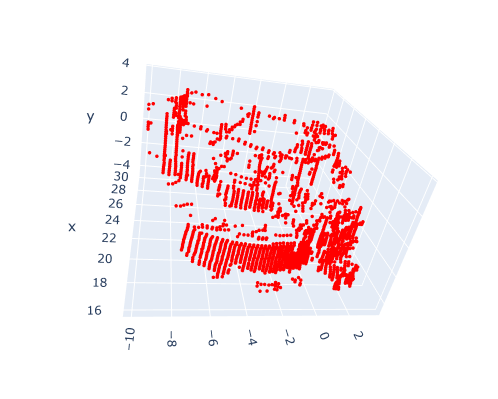

# 1.2
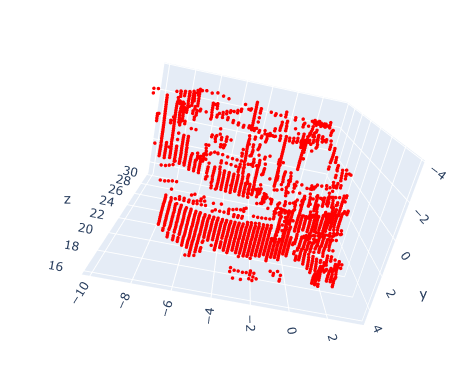

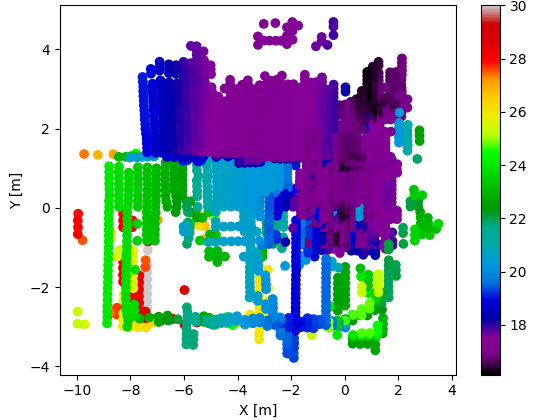

# 1.3
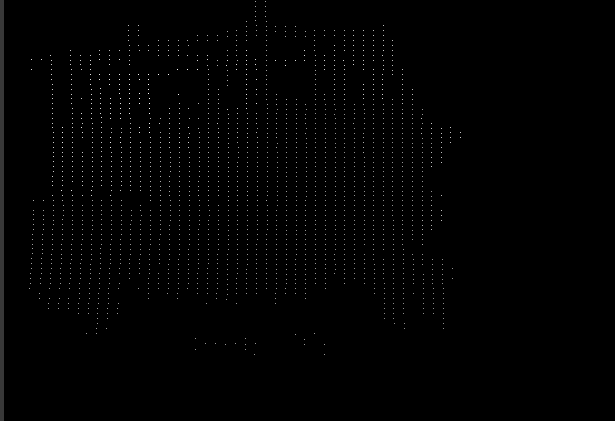

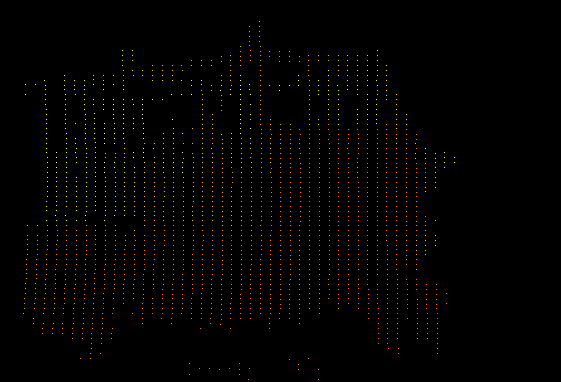

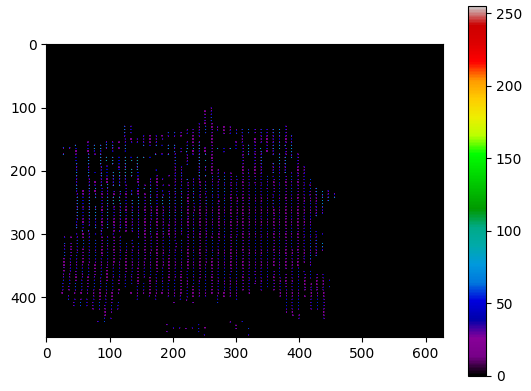

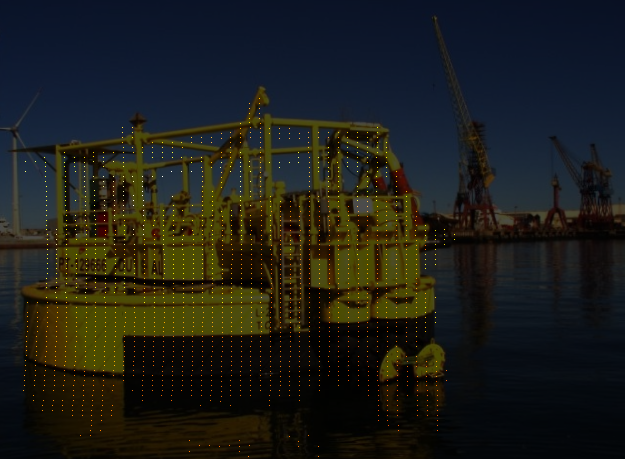

# 1.4
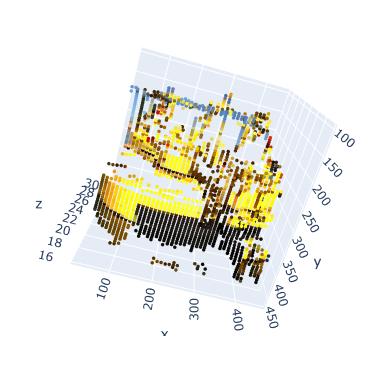

# 2.2.4

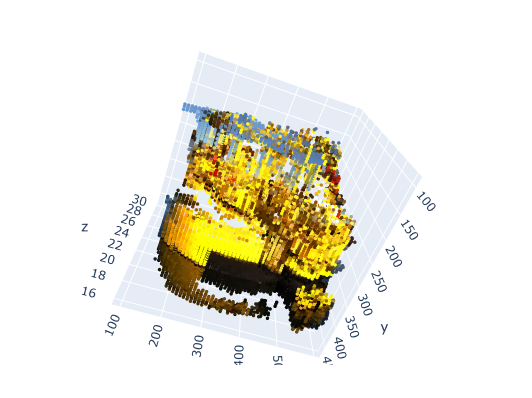

# 2.3

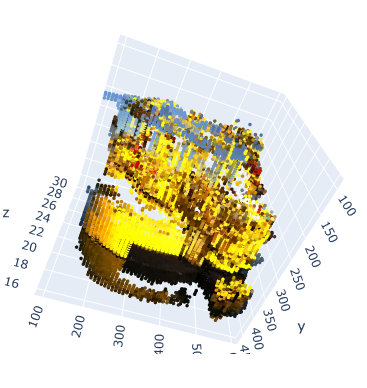

# 2.4

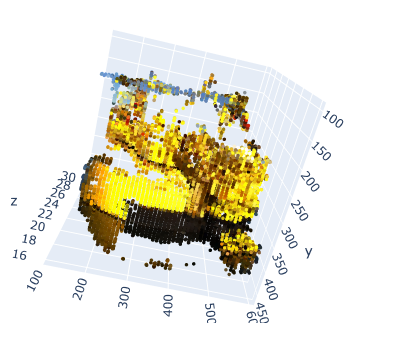